In [1]:
! pip install natsort

In [1]:
import os
import sys
import numpy as np
from natsort import natsorted
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split

In [4]:
masked_image = [os.path.join('/drive/contenet/cv-dataset/mask/',file) for file in natsorted(os.listdir('/drive/contenet/cv-dataset/mask'))]
retina_image = [os.path.join('/drive/contenet/cv-dataset/retina/',file) for file in natsorted(os.listdir('/drive/contenet/cv-dataset/retina'))]

In [5]:
train_masked_image, test_masked_image = train_test_split(masked_image, test_size=0.2, random_state=42)
train_retina_image, test_retina_image = train_test_split(retina_image, test_size=0.2, random_state=42)

In [7]:

def preprocess_retina_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.resize(image, (256, 256))
    image = image / 255.0
    return image

def preprocess_mask_image(image_path):
    mask = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.resize(mask, (256, 256))
    mask = mask / 255.0
    return np.expand_dims(mask, axis=-1)

def load_image(image_path, mask=False):
    if mask:
        return preprocess_mask_image(image_path)
    else:
        return preprocess_retina_image(image_path)

def load_data(retina_image_paths, mask_image_paths):
    retina_images = [load_image(img_path, mask=False) for img_path in retina_image_paths]
    mask_images = [load_image(img_path, mask=True) for img_path in mask_image_paths]
    return retina_images, mask_images

def generator(retina_image_paths, mask_image_paths, batch_size):
    while True:
        for i in range(0, len(mask_image_paths), batch_size):
            batch_retina_paths = retina_image_paths[i:i+batch_size]
            batch_mask_paths = mask_image_paths[i:i+batch_size]
            retina_images, mask_images = load_data(batch_retina_paths, batch_mask_paths)
            yield np.array(retina_images), np.array(mask_images)

In [8]:
import matplotlib.pyplot as plt

def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if image.shape[-1] == 1:  # If the image has a single channel (mask)
            plt.imshow(image.squeeze(), cmap='gray')
        else:
            plt.imshow(image)
    plt.show()


In [9]:
train_dataset = generator(train_retina_image, train_masked_image,32)
test_dataset = generator(test_retina_image, test_masked_image,32)

(32, 256, 256, 3) (32, 256, 256, 1)


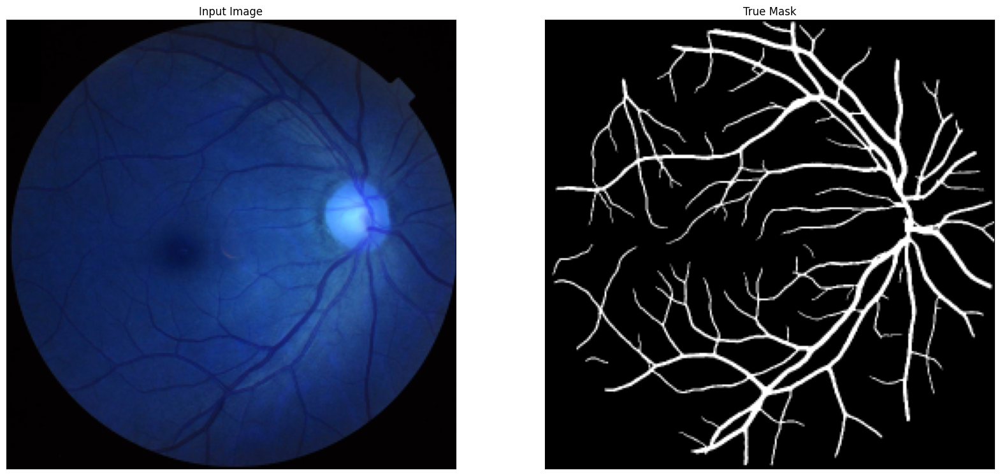

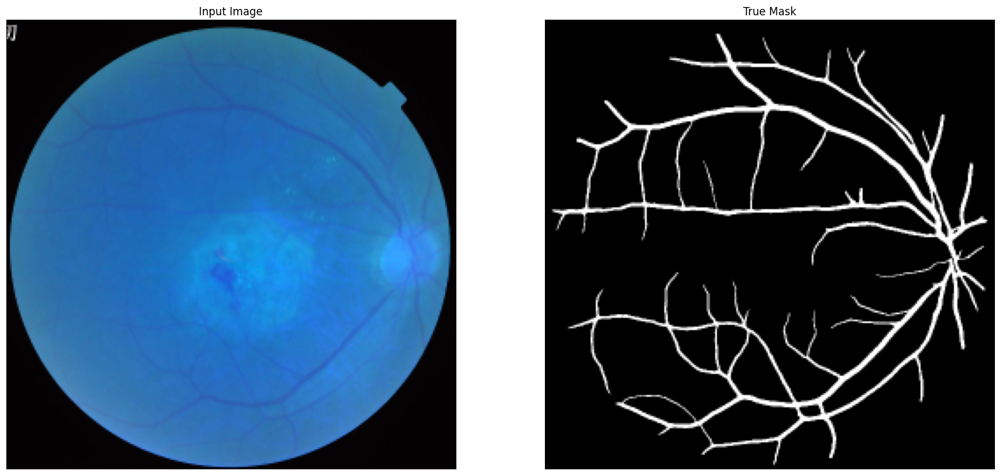

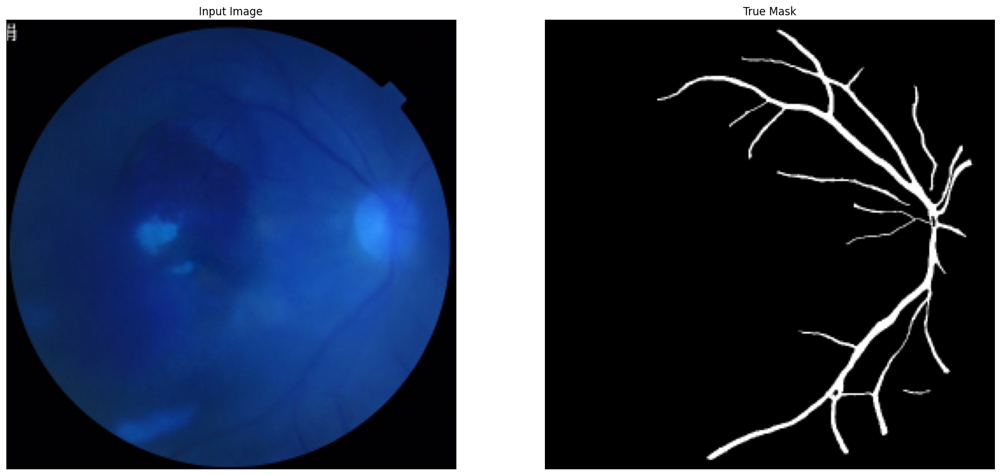

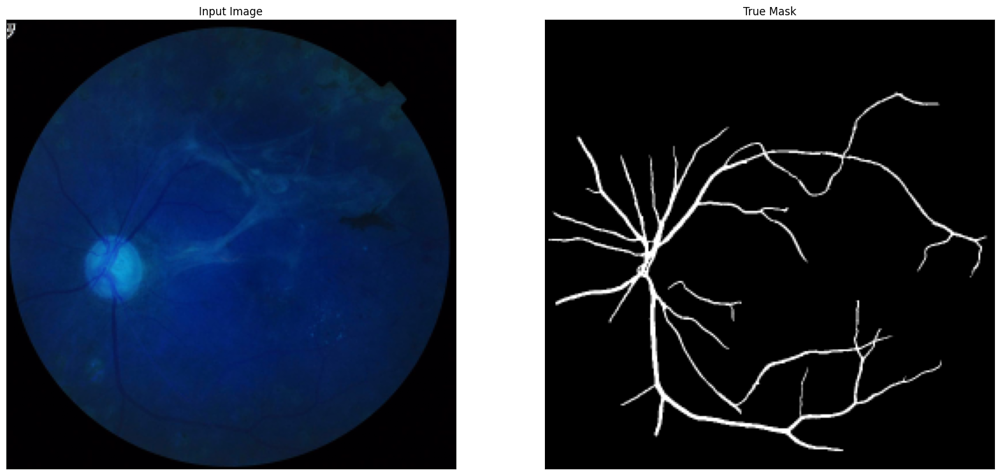

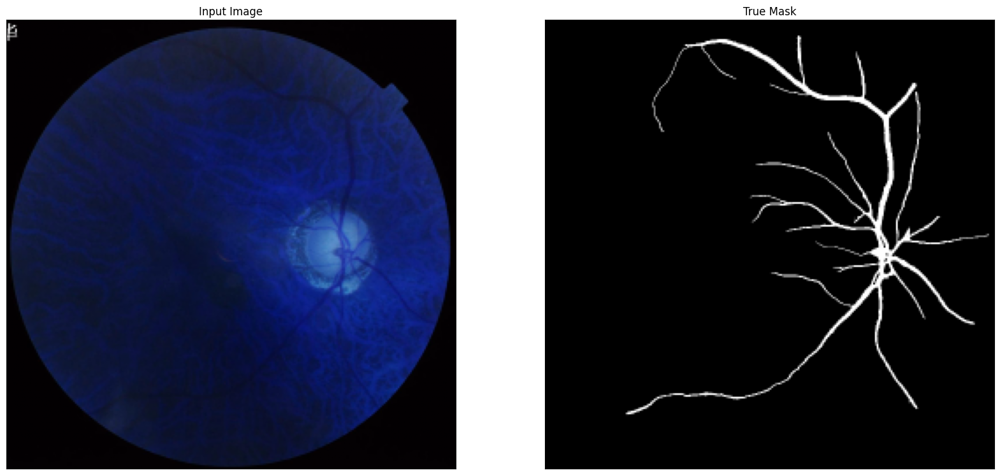

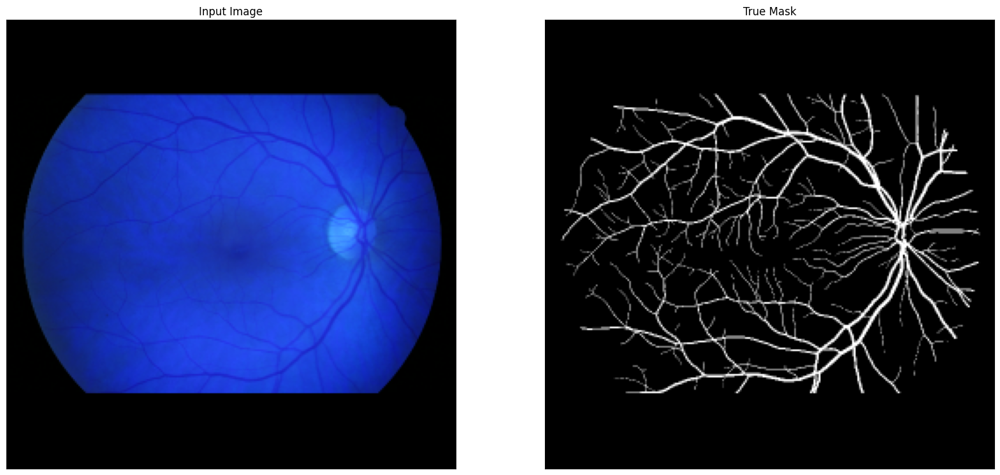

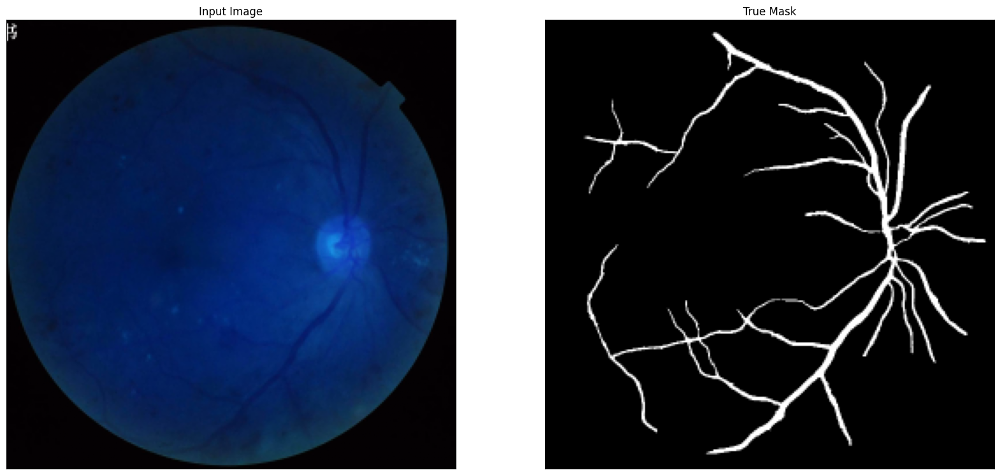

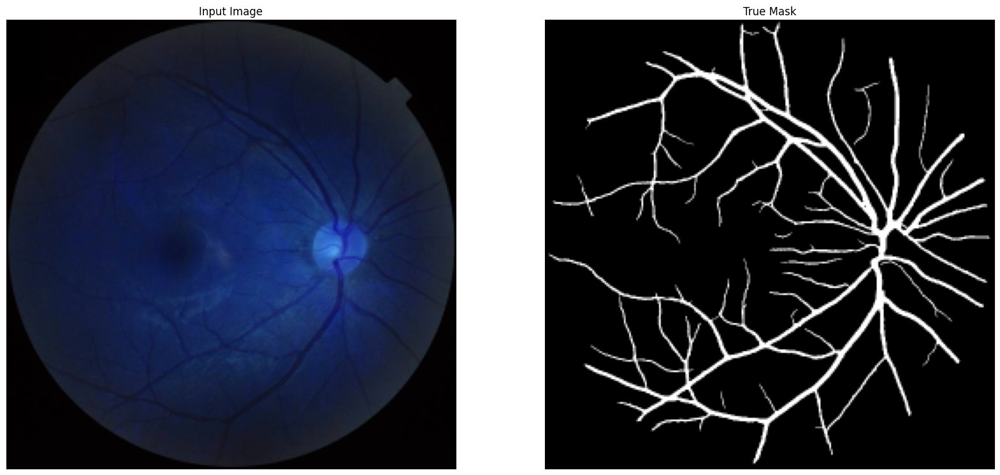

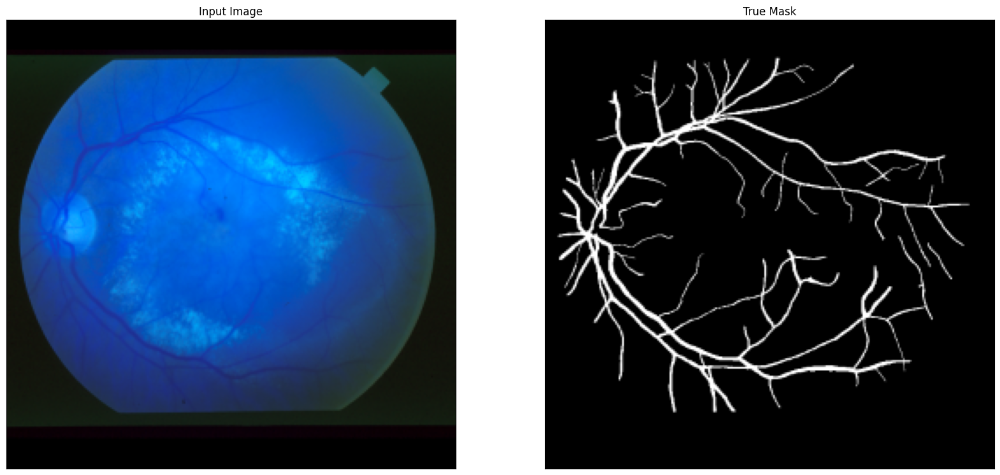

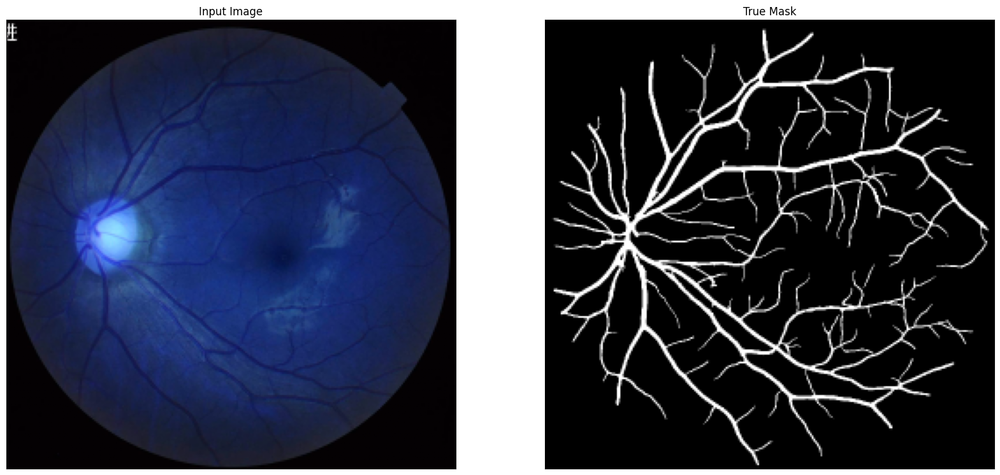

In [10]:
retina_images, mask_images = next(train_dataset)
print(retina_images.shape, mask_images.shape)

for i in range(10):
    visualize(Input_Image=retina_images[i], True_Mask=mask_images[i])


In [11]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate,BatchNormalization,Activation,Conv2DTranspose
from tensorflow.keras.models import Model

In [12]:
def build_unet_model():
    input_layer = Input(shape=(256, 256, 3))
    
    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(input_layer)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    
    # Decoder
    up6 = Conv2DTranspose(512, 2, strides=(2, 2), activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    merge6 = concatenate([conv4, up6], axis=3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    
    up7 = Conv2DTranspose(256, 2, strides=(2, 2), activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    
    up8 = Conv2DTranspose(128, 2, strides=(2, 2), activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    
    up9 = Conv2DTranspose(64, 2, strides=(2, 2), activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    
    output_layer = Conv2D(1, (1,1), activation='sigmoid')(conv9)
    
    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer='adam', loss='binary_crossentropy',metrics=['accuracy'])
    
    return model

In [13]:
unet_model = build_unet_model()
unet_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │      1,792 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │     36,928 │ conv2d[0][0]      │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │    147,584 │ conv2d_2[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │    590,080 │ conv2d_4[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 32, 32,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 32, 32,    │  1,180,160 │ max_pooling2d_2[… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 32, 32,    │  2,359,808 │ conv2d_6[0][0]    │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 16, 16,    │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 16, 16,    │  4,719,616 │ max_pooling2d_3[… │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 16, 16,    │  9,438,208 │ conv2d_8[0][0]    │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 32, 32,    │  2,097,664 │ conv2d_9[0][0]    │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 32, 32,    │          0 │ conv2d_7[0][0], 

 Total params: 31,031,745 (118.38 MB)

 Trainable params: 31,031,745 (118.38 MB)

 Non-trainable params: 0 (0.00 B)

In [14]:
unet_model.fit(train_dataset, epochs=50, steps_per_epoch=len(train_masked_image)//32, validation_data=test_dataset, validation_steps=len(test_masked_image)//32)

Epoch 1/50


2024-06-23 01:00:28.795057: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[64,64,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,256,256]{3,2,1,0}, f32[32,64,256,256]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-23 01:00:32.241429: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 4.446470538s
Trying algorithm eng0{} for conv (f32[64,64,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,256,256]{3,2,1,0}, f32[32,64,256,256]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-23 01:00:36.553042: E external/

25/26 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.7695 - loss: 0.4905

2024-06-23 01:04:20.662071: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[64,128,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[7,128,256,256]{3,2,1,0}, f32[7,64,256,256]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-23 01:04:21.169183: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.507277757s
Trying algorithm eng0{} for conv (f32[64,128,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[7,128,256,256]{3,2,1,0}, f32[7,64,256,256]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-23 01:04:23.547402: E external/

26/26 ━━━━━━━━━━━━━━━━━━━━ 422s 5s/step - accuracy: 0.7763 - loss: 0.4824 - val_accuracy: 0.8898 - val_loss: 0.2546
Epoch 2/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 98s 4s/step - accuracy: 0.8944 - loss: 0.2491 - val_accuracy: 0.8900 - val_loss: 0.2320
Epoch 3/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.8942 - loss: 0.2240 - val_accuracy: 0.8902 - val_loss: 0.2163
Epoch 4/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.8943 - loss: 0.2100 - val_accuracy: 0.8923 - val_loss: 0.2036
Epoch 5/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.8973 - loss: 0.1908 - val_accuracy: 0.8939 - val_loss: 0.1852
Epoch 6/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.9007 - loss: 0.1782 - val_accuracy: 0.9019 - val_loss: 0.1664
Epoch 7/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.9043 - loss: 0.1605 - val_accuracy: 0.9045 - val_loss: 0.1559
Epoch 8/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.9068 - loss: 0.1510 - val_accuracy: 0.9059 - val_loss: 0.1477
Ep

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step


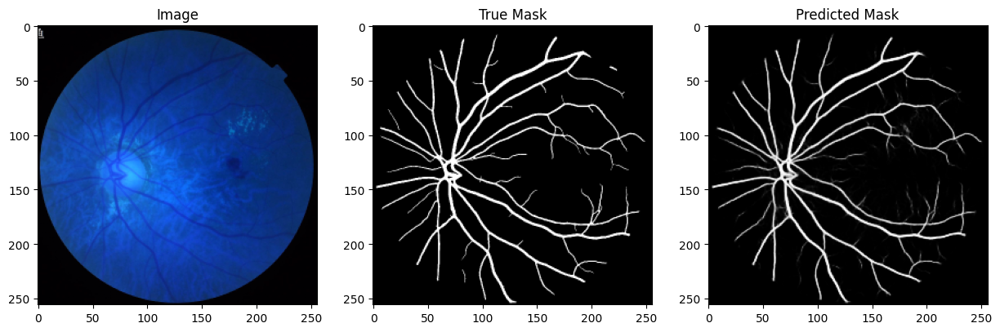

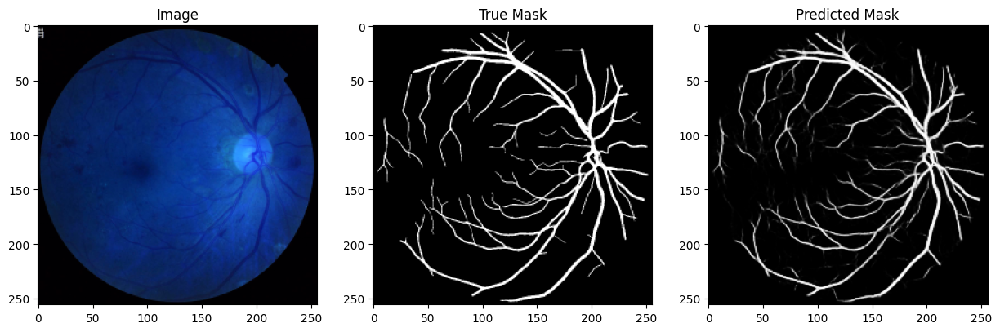

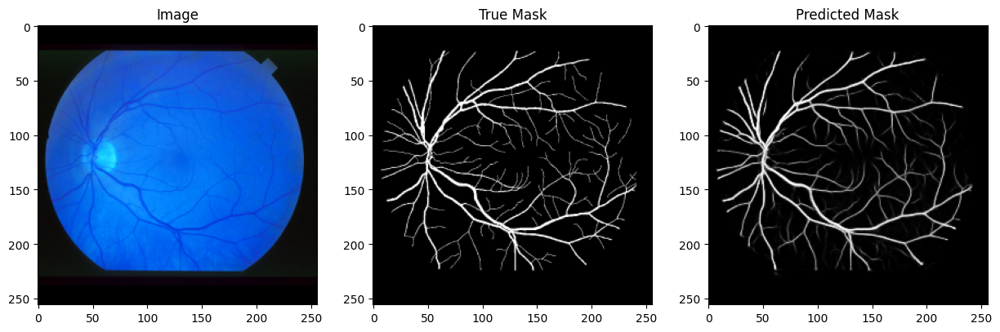

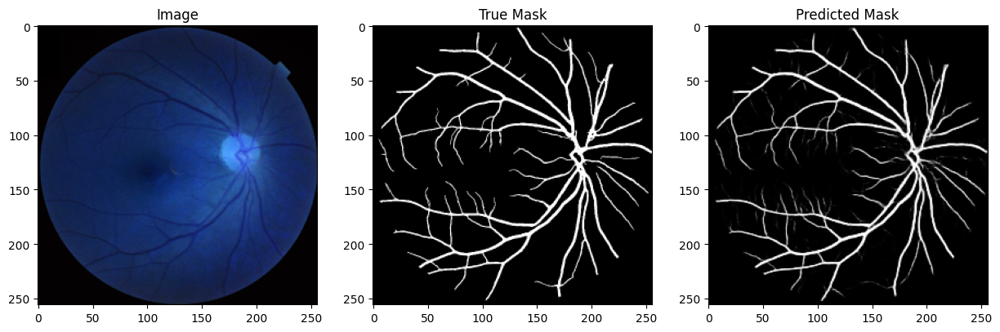

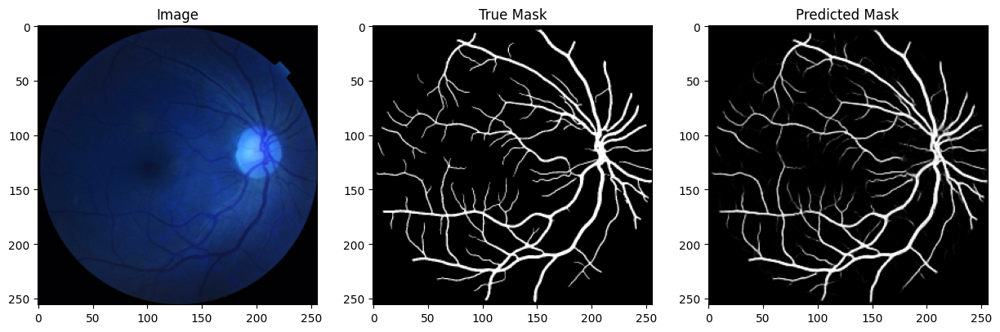

...

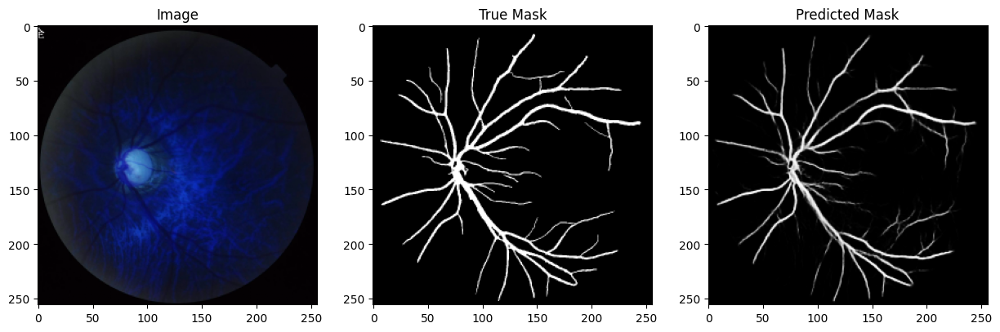

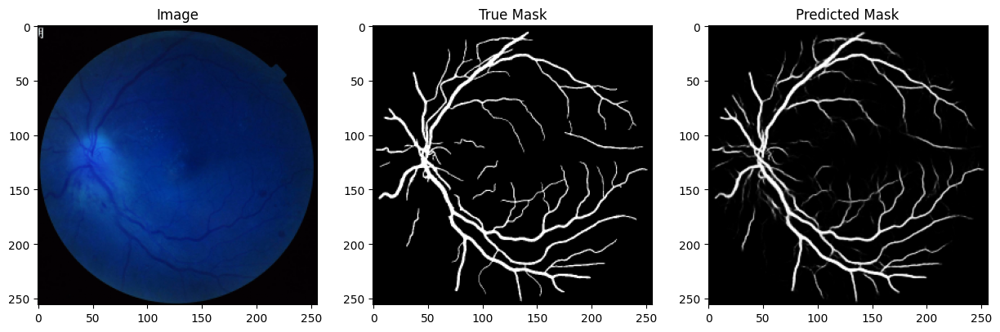

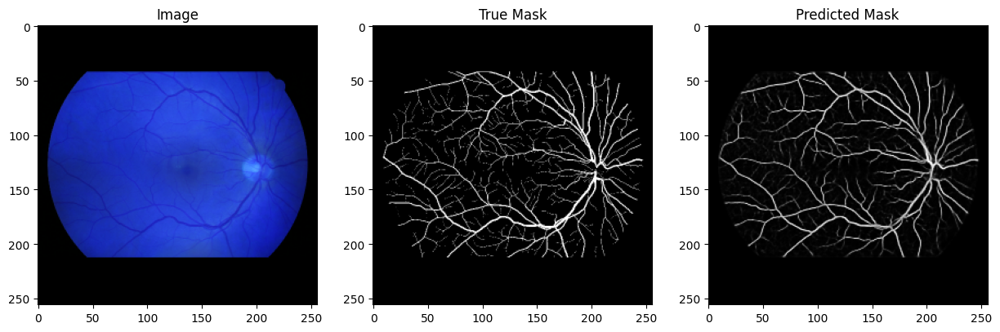

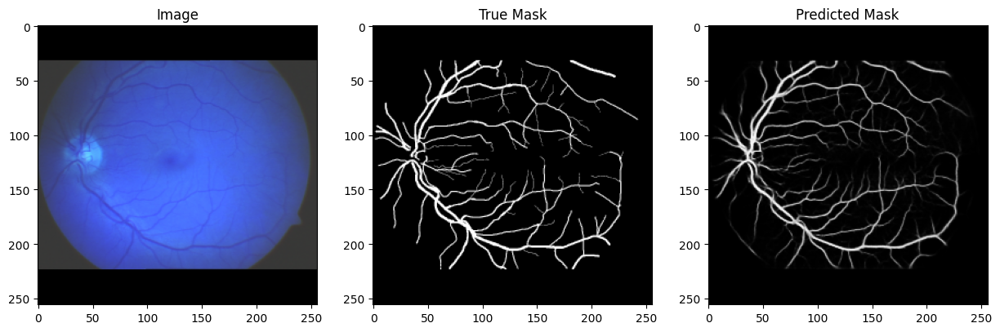

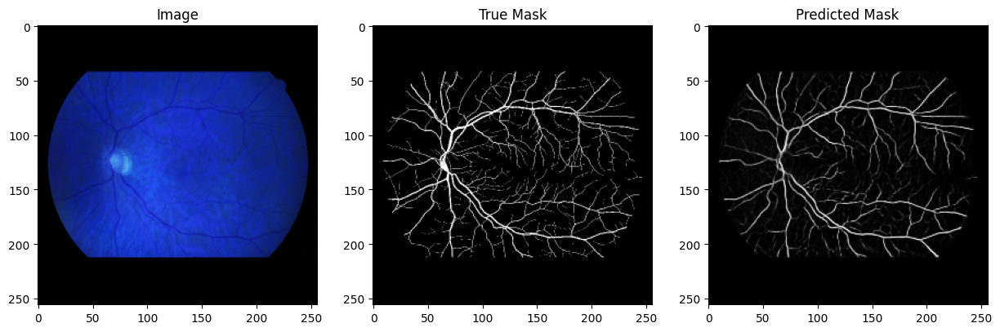

In [15]:
images, masks = next(iter(test_dataset))
preds = unet_model.predict(images)

for index in range(15):
  plt.figure(figsize=(15, 6))

  plt.subplot(1, 3, 1)
  plt.title('Image')
  plt.imshow(images[index])

  plt.subplot(1, 3, 2)
  plt.title('True Mask')
  plt.imshow(masks[index], cmap='gray')

  plt.subplot(1, 3, 3)
  plt.title('Predicted Mask')
  plt.imshow(preds[index], cmap='gray')

  plt.show()

In [7]:
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model

In [16]:
unet_model.save('unet_model.h5')

In [12]:
def build_segnet_model():
    input_layer = Input(shape=(256, 256, 3))
    
    # Encoder
    conv1 = Conv2D(64, 3, padding='same')(input_layer)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    conv1 = Conv2D(64, 3, padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(conv1)
    
    conv2 = Conv2D(128, 3, padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)
    conv2 = Conv2D(128, 3, padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(conv2)
    
    conv3 = Conv2D(256, 3, padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Activation('relu')(conv3)
    conv3 = Conv2D(256, 3, padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    conv3 = Activation('relu')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(conv3)
    
    conv4 = Conv2D(512, 3, padding='same')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Activation('relu')(conv4)
    conv4 = Conv2D(512, 3, padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Activation('relu')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(conv4)
    
    # Decoder
    up4 = UpSampling2D(size=(2, 2))(pool4)
    up4 = Conv2D(512, 3, padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    up4 = Conv2D(512, 3, padding='same')(up4)
    up4 = BatchNormalization()(up4)
    up4 = Activation('relu')(up4)
    
    up3 = UpSampling2D(size=(2, 2))(up4)
    up3 = Conv2D(256, 3, padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    up3 = Conv2D(256, 3, padding='same')(up3)
    up3 = BatchNormalization()(up3)
    up3 = Activation('relu')(up3)
    
    up2 = UpSampling2D(size=(2, 2))(up3)
    up2 = Conv2D(128, 3, padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    up2 = Conv2D(128, 3, padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    
    up1 = UpSampling2D(size=(2, 2))(up2)
    up1 = Conv2D(64, 3, padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    up1 = Conv2D(64, 3, padding='same')(up1)
    up1 = BatchNormalization()(up1)
    up1 = Activation('relu')(up1)
    
    output_layer = Conv2D(1, 1, activation='sigmoid')(up1)
    
    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    return model


In [13]:
sgnet_model = build_segnet_model()
sgnet_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 256, 256, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 256, 256, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 128, 128, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 128, 128, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 64, 64, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 64, 64, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 32, 32, 256)    │             

 Total params: 11,743,745 (44.80 MB)

 Trainable params: 11,736,065 (44.77 MB)

 Non-trainable params: 7,680 (30.00 KB)

In [19]:
train_dataset = generator(train_retina_image,train_masked_image, 32)
test_dataset = generator(test_retina_image,test_masked_image, 32)
sgnet_model.fit(train_dataset, epochs=50, steps_per_epoch=len(train_masked_image)//32, validation_data=test_dataset, validation_steps=len(test_masked_image)//32)

Epoch 1/50


2024-06-23 01:35:04.056077: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng36{k2=1,k3=0} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,128,256,256]{3,2,1,0}, f32[64,128,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-06-23 01:35:04.070445: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.01449068s
Trying algorithm eng36{k2=1,k3=0} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,128,256,256]{3,2,1,0}, f32[64,128,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}

26/26 ━━━━━━━━━━━━━━━━━━━━ 222s 2s/step - accuracy: 0.7471 - loss: 0.4628 - val_accuracy: 0.0366 - val_loss: 6769.4360
Epoch 2/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 160s 5s/step - accuracy: 0.8983 - loss: 0.2114 - val_accuracy: 0.6850 - val_loss: 119.0330
Epoch 3/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9070 - loss: 0.1783 - val_accuracy: 0.8772 - val_loss: 0.3298
Epoch 4/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9100 - loss: 0.1583 - val_accuracy: 0.8896 - val_loss: 0.6811
Epoch 5/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9122 - loss: 0.1442 - val_accuracy: 0.8891 - val_loss: 0.2682
Epoch 6/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9133 - loss: 0.1339 - val_accuracy: 0.8909 - val_loss: 0.2592
Epoch 7/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9153 - loss: 0.1261 - val_accuracy: 0.8914 - val_loss: 0.2894
Epoch 8/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9166 - loss: 0.1189 - val_accuracy: 0.8897 - val_loss: 0.3

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


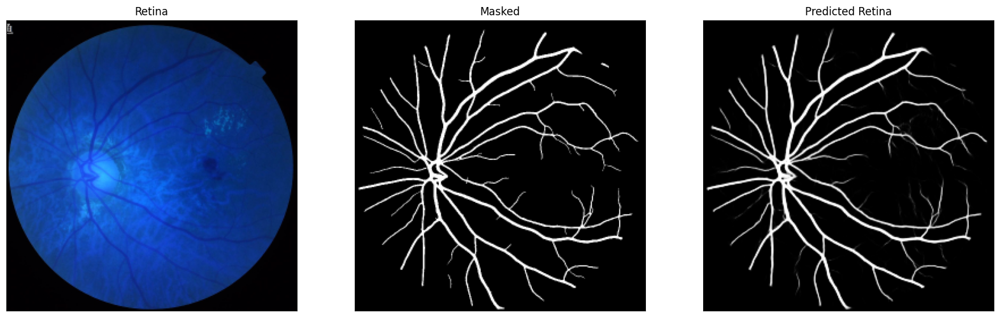

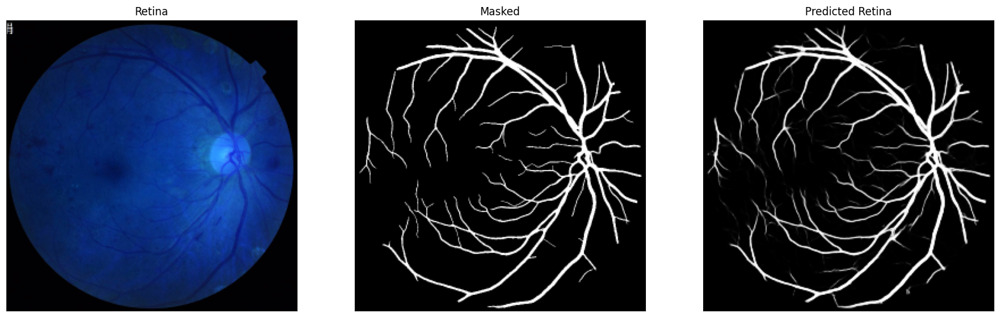

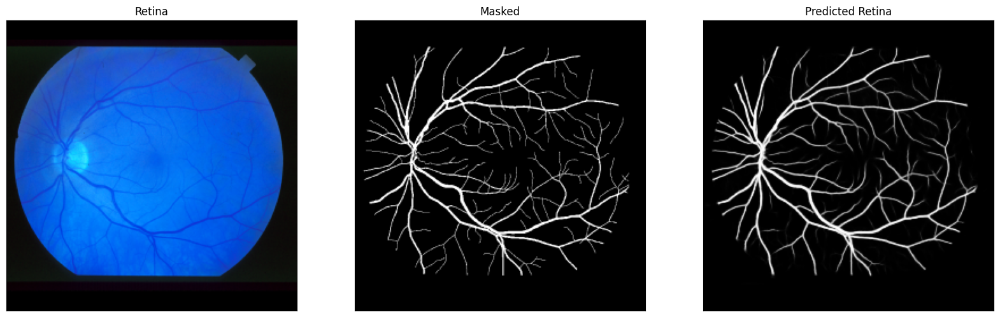

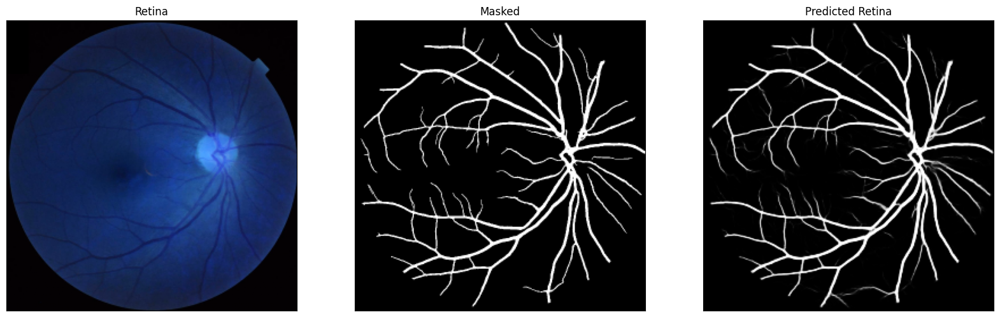

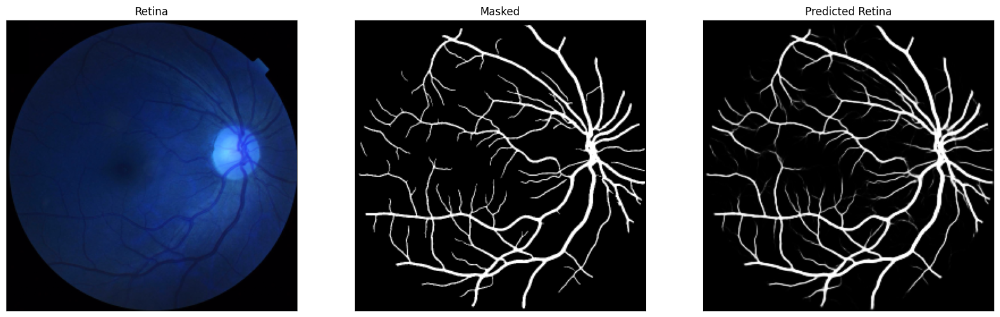

...

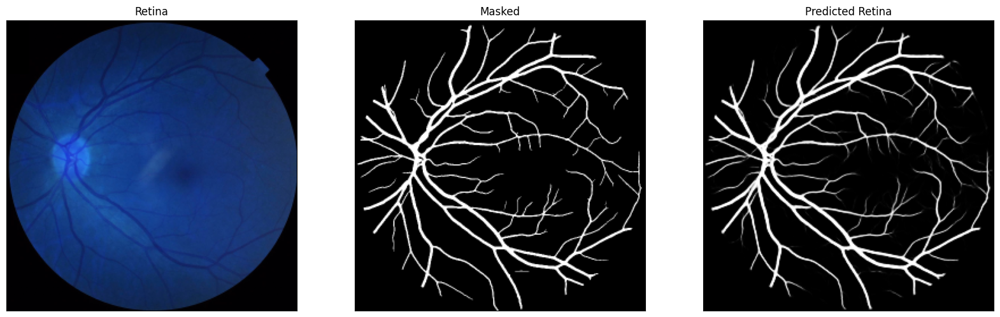

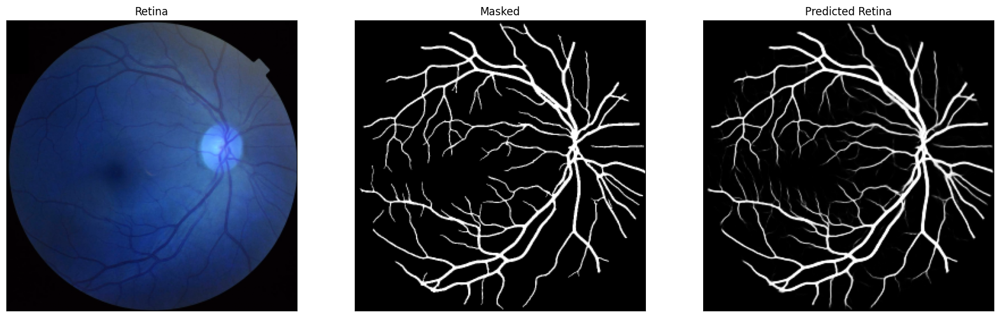

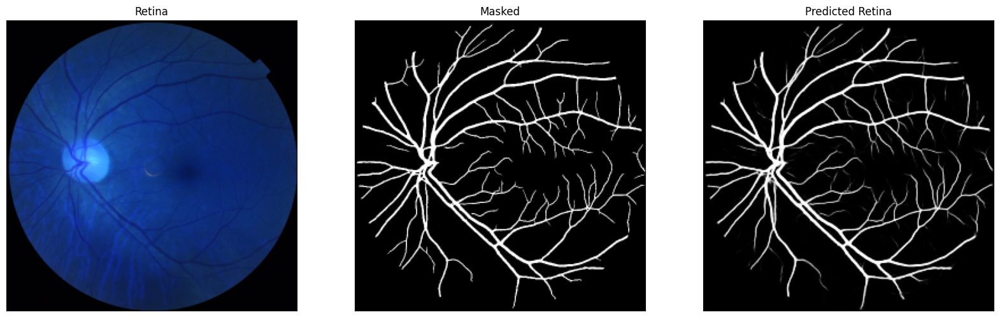

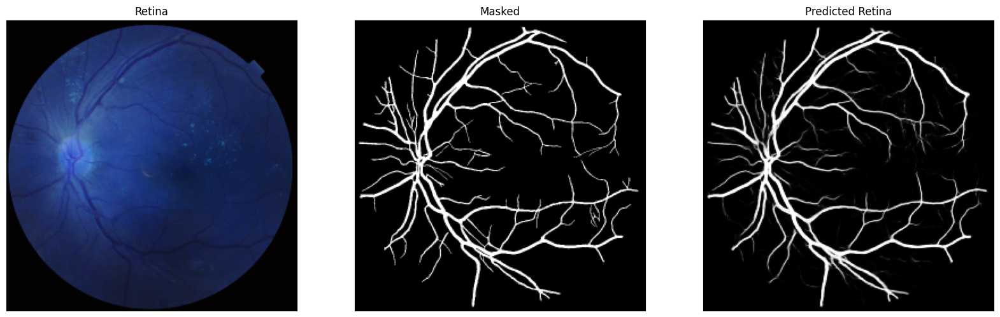

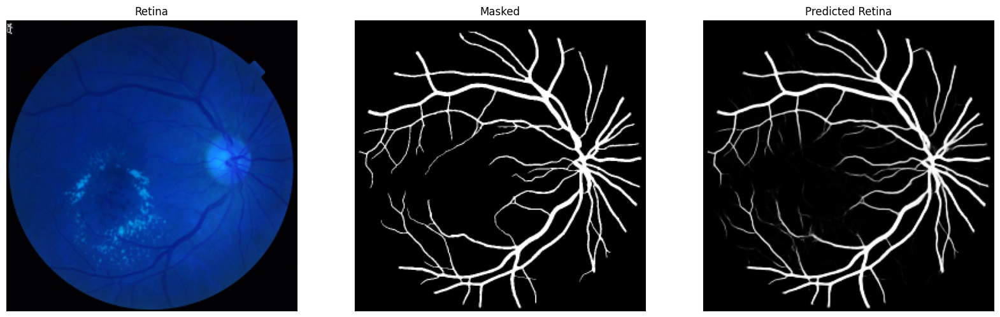

In [20]:
retina_images, masked_images = next(test_dataset)
predicted_retina_images = sgnet_model.predict(retina_images)
for i in range(len(retina_images)):
    visualize(retina=retina_images[i],masked=masked_images[i], predicted_retina=predicted_retina_images[i])

In [21]:
sgnet_model.save('sgnet_model.h5')